<a href="https://colab.research.google.com/github/lacykaltgr/agriculture-image-processing/blob/laci420/tree_trunk_segmentation/detectron.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-ek8z8eiz
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-ek8z8eiz
  Resolved https://github.com/facebookresearch/detectron2.git to commit 8c4a333ceb8df05348759443d0206302485890e0
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 6.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 12.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 16.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for detectron2: filename=detectron2-0.6-cp310-cp310-linux_x86_64.whl size=6112423 sha256=651f37c06fc7a69777339079eb5ee23e

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!cp -r /content/drive/MyDrive/colab/treetrunk/output .

In [4]:
!python r_cnn.py

[09/18 17:52:32 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/R-50_RGB_60k.pth ...
/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
qt.qpa.xcb: could not connect to display 
qt.qpa.plugin: Could not load the Qt platform plugin "xcb" in "/usr/local/lib/python3.10/dist-packages/cv2/qt/plugins" even though it was found.
This application failed to start because no Qt platform plugin could be initialized. Reinstalling the application may fix this problem.

Available platform plugins are: xcb.



[09/18 18:02:22 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/R-50_RGB_60k.pth ...


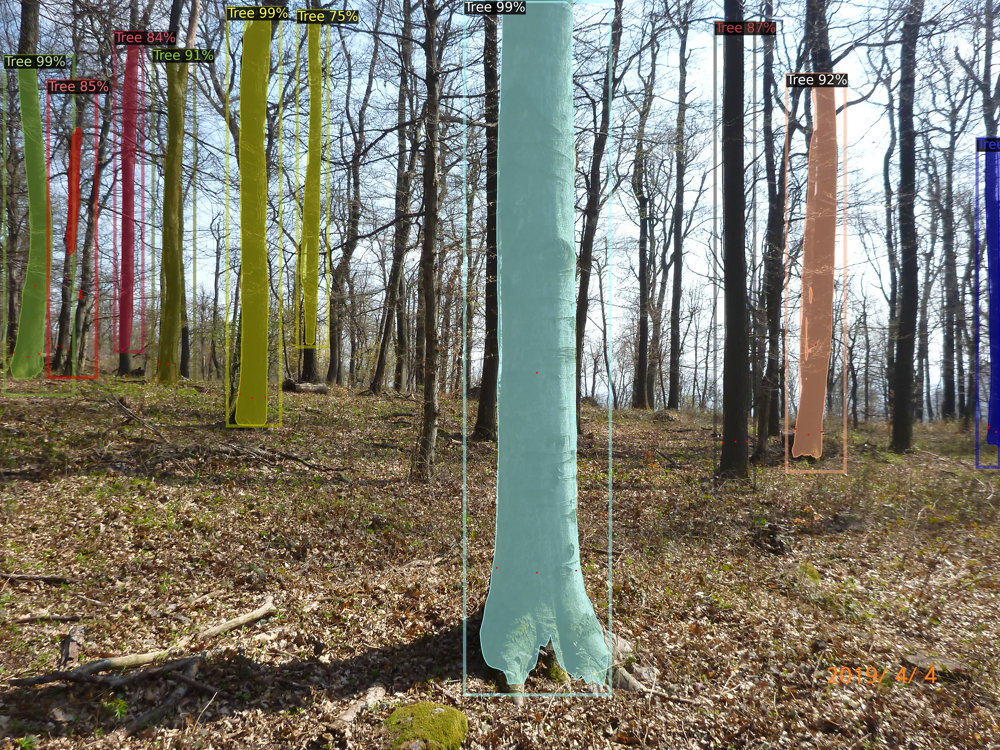

In [10]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Test trained network on a video
"""
from __future__ import  absolute_import

# Setup detectron2 logger
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import os, cv2
import torch

# import detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.data import MetadataCatalog
from detectron2.utils.visualizer import Visualizer
from google.colab.patches import cv2_imshow


# local paths to model and image
model_name = 'R-50_RGB_60k.pth'
image_path = 'output/4_3_images/P1010169.JPG'


torch.cuda.is_available()
logger = setup_logger(name=__name__)

# All configurables are listed in /repos/detectron2/detectron2/config/defaults.py
cfg = get_cfg()
cfg.INPUT.MASK_FORMAT = "bitmask"
#cfg.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_X_101_32x8d_FPN_3x.yaml"))
# cfg.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_R_101_FPN_3x.yaml"))
cfg.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ()
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 8
cfg.SOLVER.IMS_PER_BATCH = 8
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256   # faster (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (tree)
cfg.MODEL.SEM_SEG_HEAD.NUM_CLASSES = 1
cfg.MODEL.ROI_KEYPOINT_HEAD.NUM_KEYPOINTS = 5
cfg.MODEL.MASK_ON = True

cfg.OUTPUT_DIR = './output'
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, model_name)
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
# cfg.INPUT.MIN_SIZE_TEST = 0  # no resize at test time

# set detector
predictor_synth = DefaultPredictor(cfg)

# set metadata
tree_metadata = MetadataCatalog.get("my_tree_dataset").set(thing_classes=["Tree"], keypoint_names=["kpCP", "kpL", "kpR", "AX1", "AX2"])

# inference
im = cv2.imread(image_path)
outputs_pred = predictor_synth(im)
v_synth = Visualizer(im[:, :, ::-1],
                      metadata=tree_metadata,
                      scale=1,
                      )
out_synth = v_synth.draw_instance_predictions(outputs_pred["instances"].to("cpu"))
cv2_imshow(out_synth.get_image()[:, :, ::-1])
k = cv2.waitKey(0)

cv2.destroyAllWindows()

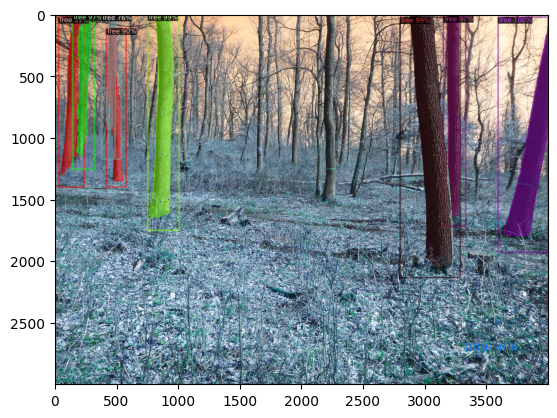

In [8]:
from matplotlib.pyplot import imshow, show

imshow(out_synth.get_image()[:, :, ::-1])
show()